# Pregunta 2


## ¿Podemos utilizar representaciones vectoriales apropiadas de los tweets y encontrar modelos descriptivos de agrupamiento de datos como clustering capaces de relacionar más aquellos tweets asociados a un mismo emoji?

## Preámbulo
El paradigma tradicional de representación vectorial de datos ha sido través de un diseño manual de atributos. 
En Procesamiento del Lenguaje Natural (PLN) existen varias aproximaciones para representar vectorialmente el texto. 
Métodos como Bag-of-word y tf-idf son formas rudimentarias de codificar la información del texto. 
Mientras que el uso de word-embeddings como word2vec y modelos del lenguaje como BERT son formas más sofisticadas de hacer lo mismo. 
Pero esta vez, aprovechándose de propiedades más complejas del texto. 
En nuestro caso, nos interesa explorar distintas aproximaciones que puedan vectorizar apropiadamente un tweet. 
Por otro lado, cada uno de los tweets de la base de datos posee un único emoji asociado. 
El emoji es una de las tantas características comunes que relacionan a los tweets. 
Hay características desde simples hasta complejas de detectar. 
Una característica simple que nos permite agrupar los tweet es la cantidad de palabras que poseen. 
Con esto, podemos tener dos grupos: aquellos con (1) varias palabras y (2) pocas palabras. 
Características complejas suelen ser más difíciles de detectar, como lo es el sentimiento de un tweet. 
Así, podemos tener tres grupos: aquellos con sentimiento (1) positivo, (2) neutro y (3) negativo. 
Ahora bien, estamos interesados en explorar distintos algoritmos de clustering con el objetivo de encontrar aquellos mas apropiados.
Es decir, que sean capaces de traducir grupos diferenciados según el único emoji presente en el tweet tanto para inglés como para español. 
Entre los algoritmos a explorar estan: k-means, aglomerativo, gaussian mixtures, dbscan y optics.

## Propuesta metodológica

En lo que sigue se detallara la propuesta metodológica ilustrada en la **Figura 1.**

**Figura 1.** *Diagrama de trabajo para analisis de clustering*

<img src="p2_clustering.png" alt="drawing" width="600"/>

Primero, nuestro conjunto de datos esta separado por idioma (Ingles y Español) y por particion de ajuste (Entrenamiento/Evaluacion/Prueba). Cada dato consiste en un tweet junto a su etiqueta (indice asociado al emoji). Ahora bien, para utilizar algoritmos de clustering es necesario representar vectorialmente cada tweet. Para esto, consideramos cinco metodos. Tres de estos sirve tanto para Ingles como para Español. Estos son: bag-of-word, tf-idf y word2vec. Luego, para Español consideramos BETO (BERT pero entrenado con un corpus en español). Mientras que para Ingles, consideramos BERTweet (BERT pero entrenado con tweets en ingles). Ver **Tabla 1.** para mas detalles de estos metodos. Brevemente, los primeros dos metodos siguen la forma tradicional de representacion de texto. Mientras que los demas, siguen el paradigma de aprendizaje de representaciones. Estas representaciones provienen de capa especificas en redes neuronales. Por otro lado, aquellos inspirados en BERT, siguen el paradigma de aprendizaje profundo.

**Tabla 1.** *Representación del tweet*

|       Notación    |   Método      |  🇺🇸     |   🇪🇸    | Libreria |
|-------------------|---------------|---------|--------|----------|
|       BOW         | [bag-of-words](https://en.wikipedia.org/wiki/Bag-of-words_model)                                                            |  ✔️   |   ✔️   | [sklearn](https://scikit-learn.org/stable/modules/feature_extraction.html#the-bag-of-words-representation)|
|       TFIDF       | [term-frecuency invert-document-frecuency](https://en.wikipedia.org/wiki/Tf%E2%80%93idf)                                    |  ✔️    |   ✔️   | [sklearn](https://scikit-learn.org/stable/modules/feature_extraction.html#tfidf-term-weighting)           |
| W2V               | [Word2vec](https://en.wikipedia.org/wiki/Word2vec)                                                                          | ✔️     | ✔️     | [gensim](https://radimrehurek.com/gensim/models/word2vec.html)                                            |
|       BETO        | [BETO: Spanish BERT](https://github.com/dccuchile/beto)                                                                     |       |   ✔️   | [🤗](https://huggingface.co/dccuchile/bert-base-spanish-wwm-cased)                                |
|       BERTweet    | [BERTweet: A pre-trained language model for English Tweets](https://aclanthology.org/2020.emnlp-demos.2/)                   |  ✔️    |       | [🤗](https://huggingface.co/vinai/bertweet-base)                                                  |

Luego de representar cada tweet como un vector con alguno de los metodos propuestos, consideramos cinco algoritmos distintos para agrupar los datos en clusters. Estos son: k-means, Jerarquico aglomerativo, dbscan, optics y Mixturas Gaussianas. Ver **Tabla 2.** para mas detalle. Se indicaran tantos clusters como emojis, siempre que el metodo lo permita. La idea es encontrar el metodo mas apropiado para nuestra tarea principal (predecir el emoji). Es decir, aquel que mejor agrupe aquellos tweets asociados a un mismo emoji y, al mismo tiempo, distinguir aquellos tweets asociado a un emoji diferente. Para medir esto finalizamos con una evaluacion y visualizacion del clustering.

**Tabla 2.** *Algoritmos de clustering*

|       Notación    |   Método      | param: #(clusters) |  Libreria |
|-------------------|---------------|------|---------|
| kMeans           | [k-means](https://en.wikipedia.org/wiki/K-means_clustering)           | ✔️ |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) |
| Agg      | [Agglomerative Hierarchical](https://en.wikipedia.org/wiki/Hierarchical_clustering)      | ✔️ |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering) |
| DBSCAN            | [Density-based spatial clustering of applications with noise](https://en.wikipedia.org/wiki/DBSCAN)            | |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html#sklearn.cluster.DBSCAN) | 
| OPTICS            | [Ordering points to identify the clustering structure](https://en.wikipedia.org/wiki/OPTICS_algorithm)      |  | [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.OPTICS.html#sklearn.cluster.OPTICS) |
| GM  | [Gaussian Mixture](https://en.wikipedia.org/wiki/Mixture_model#Gaussian_mixture_model)  | ✔️ |[sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.mixture.GaussianMixture.html#sklearn.mixture.GaussianMixture) |

Para evaluar cuantitativamente el clustering, consideramos siete metricas. Como se tienen las etiquetas correctas de los puntos, entonces podemos considerar metricas similares a Accuracy, Precision, Recall y F1-score, para evaluar los clusters. Estas metricas son: Rand index, Mutual Information, Homogeneity, Completeness y V-measure. Por otro lado, consideramos dos metricas adicionales que no requieren etiquetas correctas: Matriz de correlacion y Silhouette. Ver **Tabla 3.** para mas detalle.

**Tabla 3.** *Métricas de evaluación para clustering. El simbolo 🔒 indica que es necesaria dicha información para calcular la metrica*

|       Notación    |   Método               | Rango  | Ground truth (Etiquetas)    | kMeans | Agg | DBSCAN | OPTICS | GM |  Libreria |
|-------------------|------------------------|--------|-----------------------------|--------|-----|--------|--------|----|-----------|
|      Corr         | [Correlación (Pearson)](https://en.wikipedia.org/wiki/Pearson_correlation_coefficient)                        | [-1, 1]^n   |       ✔️       |   ✔️    |  ✔️  |   ✔️    |   ✔️    | ✔️  |     [🐼](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.corr.html)      |
|      SC           | [Silhouette](https://en.wikipedia.org/wiki/Silhouette_(clustering))                                           | [-1, 1]   |       ✔️       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |   [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html#sklearn.metrics.silhouette_score)        |
|      Rand         | [Rand index](https://en.wikipedia.org/wiki/Rand_index)                                                        |  [0, 1]  |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.rand_score.html#sklearn.metrics.rand_score)        |
| NMI               | [Mutual Information](https://en.wikipedia.org/wiki/Mutual_information#Normalized_variants)                          | [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.normalized_mutual_info_score.html#sklearn.metrics.normalized_mutual_info_score)        |
| Hom               | [Homogeneity](https://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure) | [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.homogeneity_score.html#sklearn.metrics.homogeneity_score)        |
| Comp              | [Completeness](https://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure)| [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.completeness_score.html#sklearn.metrics.completeness_score)        |
| V                 | [V-measure](https://scikit-learn.org/stable/modules/clustering.html#homogeneity-completeness-and-v-measure)   | [0, 1]   |       🔒       |  ✔️     | ✔️   |    ✔️   |    ✔️   |✔️   |  [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.v_measure_score.html#sklearn.metrics.v_measure_score)        |


Ahora bien, para evaluar cualitativamente el clustering, se visualizaran los clusters obtenidos. Sin embargo, como los vectores viven en espacios de dimensiones mayores que dos, es necesario reducir la dimensionalidad de los vectores. Para esto, consideramos tres metodos distintos. Estos son: PCA, tSNE y UMAP. Ver **Tabla 4.** para mas detalle. La idea, es reducirnos a dimensiones interpretables como 2- y 3-dimensiones.

**Tabla 4.** *Reductores de dimensionalidad*

|       Notación    |   Método               | Libreria |
|-------------------|------------------------|----------|
|      PCA          | [Principal component analysis](https://en.wikipedia.org/wiki/Principal_component_analysis)  |   [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html)       |
|      tSNE         | [t-Distributed Stochastic Neighbor Embedding](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)  | [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html) |
|      UMAP         | [Uniform Manifold Approximation and Projection](https://arxiv.org/abs/1802.03426) | [📄](https://umap-learn.readthedocs.io/en/latest/) |

Finalmente, este analisis nos dara un entendimento de la dificultad de predecir un emoji. Si los datos no se expresan en grupos diferenciados por el emoji, es decir, que se solapan los grupos de datos para emojis distintos. Entonces, modelos de clasificacion tenderan a obtener un desempeño deficiente. Por otro lado, con esta informacion podremos encontrar otro grupos (distintos a los indicados por el emoji) que pudiesen existir en el conjunto de datos. En cambio, si los datos logran expresarse para cierta representacion del texto junto a un metodo de clustering particular, responderemos afirmativamente la pregunta.

# Resultados

## Tabla de contenidos
* [Análisis para Español](#Análisis-para-Español)
    * [Cargar y preparar los resultados](#Cargar-y-preparar-los-resultados:-ES)
    * [Análisis Cuantitativo](#Análisis-Cuantitativo:-ES)
    * [Análisis Cualitativo](#Análisis-Cualitativo:-ES)
        * [Matriz de distancias](#Matriz-de-distancias:-ES)
        * [Proyecciones 2D](#Proyecciones-2D:-ES)
            * [UMAP](#UMAP:-ES)
            * [TSNE](#TSNE:-ES)
            * [PCA](#PCA:-ES)
* [Análisis para Ingles](#Análisis-para-Ingles)
    * [Cargar y preparar los resultados](#Cargar-y-preparar-los-resultados:-US)
    * [Análisis Cuantitativo](#Análisis-Cuantitativo:-US)
    * [Análisis Cualitativo](#Análisis-Cualitativo:-US)
        * [Matriz de distancias](#Matriz-de-distancias:-US)
        * [Proyecciones 2D](#Proyecciones-2D:-US)
            * [UMAP](#UMAP:-US)
            * [TSNE](#TSNE:-US)
            * [PCA](#PCA:-US)

Librerias

In [2]:
import plotly.express as px
import pandas as pd
import pickle
import numpy as np
from os import listdir
!pip install matplotlib
import matplotlib.pyplot as plt

## Análisis para Español

### Cargar y preparar los resultados: ES

Jupyter notebooks

|Representación / Idioma     |   Español   |  Ingles     |
|----------------------------|-------------|-------------|
| BOW                        |[📄](notebooks_clustering/clusterings_usando_bow_ES.ipynb)       |[📄](notebooks_clustering/clusterings_usando_bow_US.ipynb)       |
| TF-IDF                     |[📄](notebooks_clustering/clusterings_usando_tfidf_US.ipynb)       |[📄](notebooks_clustering/clusterings_usando_tfidf_ES.ipynb)       |
| word2vec                   |[📄](notebooks_clustering/clusterings_usando_w2v_ES.ipynb)       |[📄](notebooks_clustering/clusterings_usando_w2v_US.ipynb)       |
| (ES: BETO, US: BERTweet)   |[📄](notebooks_clustering/clusterings_usando_beto_ES.ipynb)|[📄](notebooks_clustering/clusterings_usando_bertweet_US.ipynb)|

In [3]:
root_file = "/github/data-mining-2022/Hitos/H3/notebooks_clustering"
es_array_paths = [
    f 
    for f in listdir(root_file) 
    if ("es" in f) and ("pickle" in f) and ("dm" in f or "report" in f or "projection" in f)
]

In [4]:
path =  "../../Data/train/df_es_train.pickle"
df_es_train = pickle.load(open(path, "rb"))

In [5]:
sample_index_es = np.random.RandomState(0).choice(range(df_es_train.shape[0]), 20000)
labels = df_es_train.iloc[sample_index_es]["label"].values

### Análisis Cuantitativo: ES

In [6]:
es_results = []
for f in es_array_paths:
    if "report" in f:
        se, cm = f.replace("_es_report.pickle", "").split("_")
        dict_m = pickle.load(open(root_file+"/"+f, "rb"))
        for k, v in dict_m["metricas"].items():
            o = {"Vector": se, "Clustering": cm, "Metrica": k, "Valor": v}
            es_results.append(o)
df_es_results = pd.DataFrame(es_results)
df_es_results

,Vector,Clustering,Metrica,Valor
0,beto,dbscan,Silhouette,-0.053405
1,beto,dbscan,Rand score,0.092397
2,beto,dbscan,Mutual information,0.000726
3,beto,dbscan,Homogeneity,0.000365
4,beto,dbscan,Completeness,0.100454
...,...,...,...,...
91,w2v,kmeans,Rand score,0.819727
92,w2v,kmeans,Mutual information,0.026681
93,w2v,kmeans,Homogeneity,0.025777
94,w2v,kmeans,Completeness,0.027650


In [7]:
def plot_metric(df, metrica, lang="ES"):
    fig = px.bar(df[df["Metrica"] == metrica], x="Clustering", y="Valor", color="Vector",
                    width=600, height=400)
    fig.update_layout(
        title=f"{metrica}: {lang}",
        barmode='group')
    fig.show(renderer="notebook")

In [8]:
plot_metric(df_es_results, metrica="Silhouette")

In [9]:
plot_metric(df_es_results, metrica="Rand score")

In [10]:
plot_metric(df_es_results, metrica="Mutual information")

In [11]:
plot_metric(df_es_results, metrica="Homogeneity")

In [12]:
plot_metric(df_es_results, metrica="Completeness")

In [13]:
plot_metric(df_es_results, metrica="V-measure")

### Análisis Cualitativo: ES

#### Matriz de distancias: ES

In [14]:
es_dm = []
for f in es_array_paths:
    if "dm" in f:
        se, cm = f.replace("_es_dm.pickle", "").split("_")
        dict_m = pickle.load(open(root_file+"/"+f, "rb"))
        o = [(se, cm), dict_m]
        es_dm.append(o)

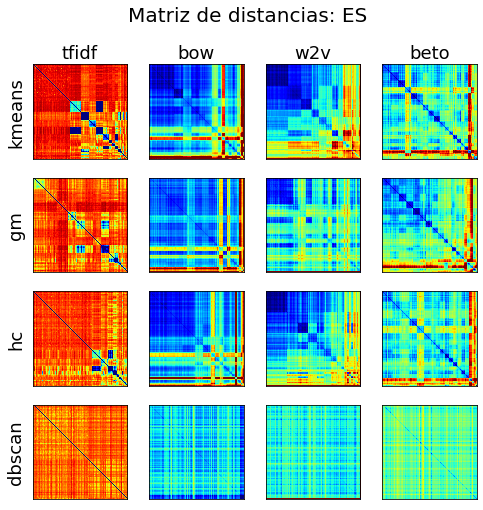

In [15]:
fig, ax = plt.subplots(4, 4, figsize=(8, 8))
q1=0.05
x0=-70
scale=1.02
num_tags=5
for k, v in enumerate(es_dm):
    v0, v1 = v
    j, i = ["tfidf", "bow", "w2v", "beto"].index(v0[0]), ["kmeans", "gm", "hc", "dbscan"].index(v0[1])
    if j==2: q3=0.95
    else: q3=0.95
    vmin = np.quantile(v1["matriz_distancias"].flatten(), q1)
    vmax = np.quantile(v1["matriz_distancias"].flatten(), q3)
    ax[i,j].imshow(v1["matriz_distancias"], cmap="jet", vmin=vmin, vmax=vmax)
    ax[i,j].set_yticks([])
    ax[i,j].set_xticks([])
    if i==0:
        ax[i,j].set_title(v0[0], size=18)
    if j==0:
        ax[i,j].set_ylabel(v0[1], size=18)
plt.suptitle("Matriz de distancias: ES", size=20);
fig.savefig('MD_ES.jpg', bbox_inches='tight')

#### Proyecciones 2D: ES

In [16]:
es_prjt = {"pca": {}, "tsne": {}, "umap": {}}
for f in es_array_paths:
    if "projection" in f:
        se, rd = f.split("_")[:2]
        reduced = pickle.load(open(root_file+"/"+f, "rb"))["reduced"]
        es_prjt[rd][se] = reduced

In [17]:
es_clusters = {"kmeans": {}, "hc": {}, "gm": {}, "dbscan": {}}
for f in es_array_paths:
    if "report" in f:
        se, cm = f.replace("_es_report.pickle", "").split("_")
        dict_m = pickle.load(open(root_file+"/"+f, "rb"))
        es_clusters[cm][se] = dict_m["clusters"]

In [18]:
plot_sample_index_es = np.random.RandomState(0).choice(range(20000), 1000)

In [19]:
def plot_prj(prj):
    alpha=0.5
    ms=7
    fig, ax = plt.subplots(4, 4, figsize=(10, 10))
    for i, cm in enumerate(["kmeans", "gm", "hc", "dbscan"]):
        for j, se in enumerate(["tfidf", "bow", "w2v", "beto"]):
            clusters = es_clusters[cm][se][plot_sample_index_es]
            x = es_prjt[prj][se][plot_sample_index_es,0]
            y = es_prjt[prj][se][plot_sample_index_es,1]
            sorted_clusters = pd.Series(clusters).value_counts().sort_values(ascending=False).index
            for cluster in sorted_clusters:
                ixs = (clusters == cluster)
                ax[i, j].scatter(
                    x[ixs],
                    y[ixs],
                    alpha=alpha,
                    s=ms
                )
            ax[i,j].set_yticks([])
            ax[i,j].set_xticks([])
            if i==0:
                ax[i,j].set_title(se, size=18)
            if j==0:
                ax[i,j].set_ylabel(cm, size=18)
    plt.suptitle(f"{prj.upper()}: ES", size=20);
    fig.savefig(f'{prj.upper()}_ES.jpg', bbox_inches='tight')

##### UMAP: ES

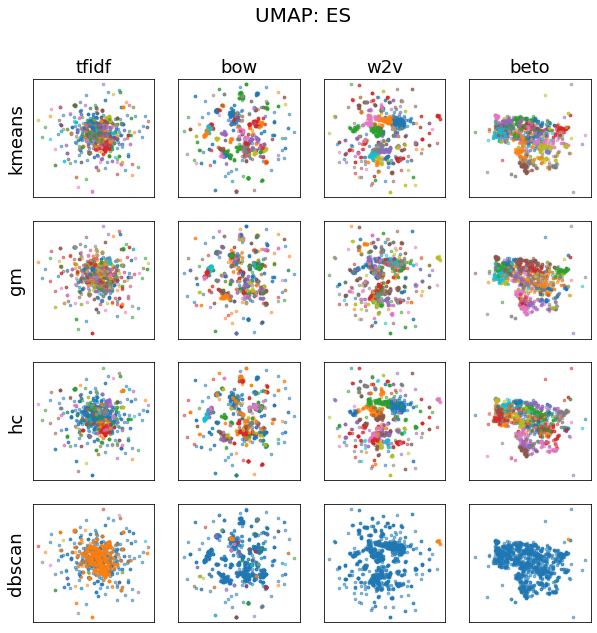

In [20]:
plot_prj("umap")

##### TSNE: ES

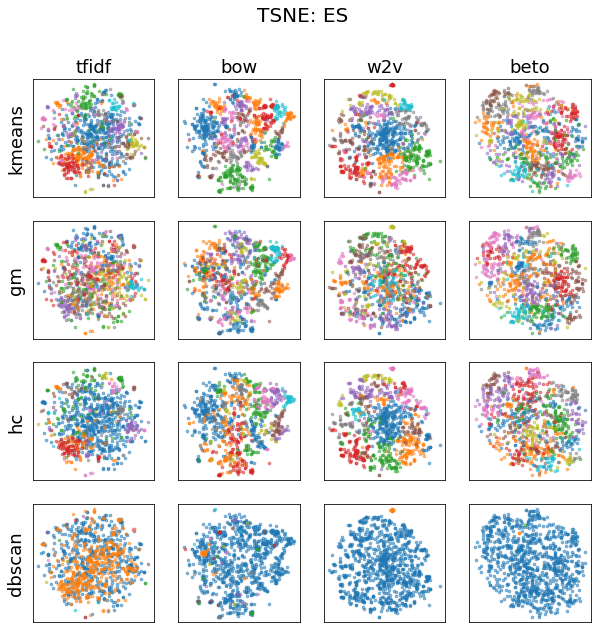

In [21]:
plot_prj("tsne")

##### PCA: ES

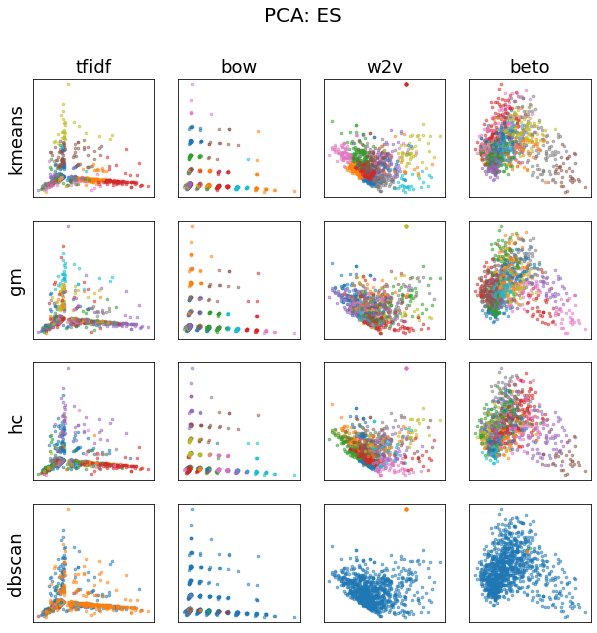

In [22]:
plot_prj("pca")

## Análisis para Ingles

### Cargar y preparar los resultados: US

In [23]:
root_file = "/github/data-mining-2022/Hitos/H3/notebooks_clustering"
us_array_paths = [
    f 
    for f in listdir(root_file) 
    if ("us" in f) and ("pickle" in f) and ("dm" in f or "report" in f or "projection" in f)
]

In [24]:
path =  "../../Data/train/df_us_train.pickle"
df_us_train = pickle.load(open(path, "rb"))

In [25]:
sample_index_us = np.random.RandomState(0).choice(range(df_us_train.shape[0]), 20000)
labels = df_us_train.iloc[sample_index_us]["label"].values

### Análisis Cuantitativo: US

In [26]:
us_results = []
for f in us_array_paths:
    if "report" in f:
        se, cm = f.replace("_us_report.pickle", "").split("_")
        dict_m = pickle.load(open(root_file+"/"+f, "rb"))
        for k, v in dict_m["metricas"].items():
            o = {"Vector": se, "Clustering": cm, "Metrica": k, "Valor": v}
            us_results.append(o)
df_us_results = pd.DataFrame(us_results)
df_us_results

,Vector,Clustering,Metrica,Valor
0,bertweet,dbscan,Silhouette,-0.196180
1,bertweet,dbscan,Rand score,0.219949
2,bertweet,dbscan,Mutual information,0.003311
3,bertweet,dbscan,Homogeneity,0.001925
4,bertweet,dbscan,Completeness,0.011831
...,...,...,...,...
91,w2v,kmeans,Rand score,0.865099
92,w2v,kmeans,Mutual information,0.062371
93,w2v,kmeans,Homogeneity,0.064443
94,w2v,kmeans,Completeness,0.060427


In [27]:
plot_metric(df_us_results, metrica="Silhouette", lang="US")

In [28]:
plot_metric(df_us_results, metrica="Rand score", lang="US")

In [29]:
plot_metric(df_us_results, metrica="Mutual information", lang="US")

In [30]:
plot_metric(df_us_results, metrica="Homogeneity", lang="US")

In [31]:
plot_metric(df_us_results, metrica="Completeness", lang="US")

In [32]:
plot_metric(df_us_results, metrica="V-measure", lang="US")

### Análisis Cualitativo: US

#### Matriz de distancias: US

In [33]:
us_dm = []
for f in us_array_paths:
    if "dm" in f:
        se, cm = f.replace("_us_dm.pickle", "").split("_")
        dict_m = pickle.load(open(root_file+"/"+f, "rb"))
        o = [(se, cm), dict_m]
        us_dm.append(o)

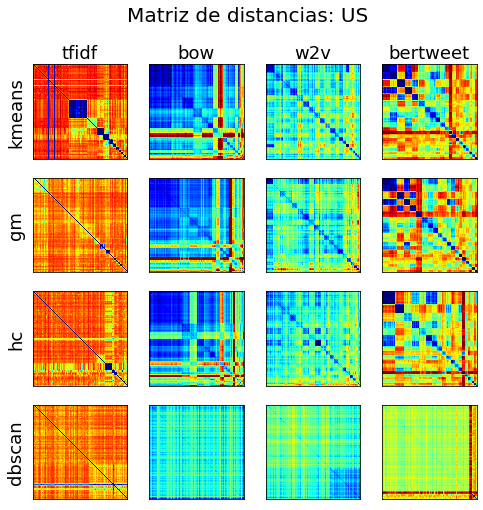

In [34]:
fig, ax = plt.subplots(4, 4, figsize=(8, 8))
q1=0.05
x0=-70
scale=1.02
num_tags=5
for k, v in enumerate(us_dm):
    v0, v1 = v
    j, i = ["tfidf", "bow", "w2v", "bertweet"].index(v0[0]), ["kmeans", "gm", "hc", "dbscan"].index(v0[1])
    if j==2: q3=0.95
    else: q3=0.95
    vmin = np.quantile(v1["matriz_distancias"].flatten(), q1)
    vmax = np.quantile(v1["matriz_distancias"].flatten(), q3)
    ax[i,j].imshow(v1["matriz_distancias"], cmap="jet", vmin=vmin, vmax=vmax)
    ax[i,j].set_yticks([])
    ax[i,j].set_xticks([])
    if i==0:
        ax[i,j].set_title(v0[0], size=18)
    if j==0:
        ax[i,j].set_ylabel(v0[1], size=18)
plt.suptitle("Matriz de distancias: US", size=20);
fig.savefig('MD_US.jpg', bbox_inches='tight')

#### Proyecciones 2D: US

In [35]:
us_prjt = {"pca": {}, "tsne": {}, "umap": {}}
for f in us_array_paths:
    if "projection" in f:
        se, rd = f.split("_")[:2]
        reduced = pickle.load(open(root_file+"/"+f, "rb"))["reduced"]
        us_prjt[rd][se] = reduced

In [36]:
us_clusters = {"kmeans": {}, "hc": {}, "gm": {}, "dbscan": {}}
for f in us_array_paths:
    if "report" in f:
        se, cm = f.replace("_us_report.pickle", "").split("_")
        dict_m = pickle.load(open(root_file+"/"+f, "rb"))
        us_clusters[cm][se] = dict_m["clusters"]

In [37]:
plot_sample_index_us = np.random.RandomState(0).choice(range(20000), 1000)

In [38]:
def plot_prj(prj):
    alpha=0.5
    ms=7
    fig, ax = plt.subplots(4, 4, figsize=(10, 10))
    for i, cm in enumerate(["kmeans", "gm", "hc", "dbscan"]):
        for j, se in enumerate(["tfidf", "bow", "w2v", "bertweet"]):
            clusters = us_clusters[cm][se][plot_sample_index_us]
            x = us_prjt[prj][se][plot_sample_index_us,0]
            y = us_prjt[prj][se][plot_sample_index_us,1]
            sorted_clusters = pd.Series(clusters).value_counts().sort_values(ascending=False).index
            for cluster in sorted_clusters:
                ixs = (clusters == cluster)
                ax[i, j].scatter(
                    x[ixs],
                    y[ixs],
                    alpha=alpha,
                    s=ms
                )
            ax[i,j].set_yticks([])
            ax[i,j].set_xticks([])
            if i==0:
                ax[i,j].set_title(se, size=18)
            if j==0:
                ax[i,j].set_ylabel(cm, size=18)
    plt.suptitle(f"{prj.upper()}: US", size=20);
    fig.savefig(f'{prj.upper()}_US.jpg', bbox_inches='tight')

##### UMAP: US

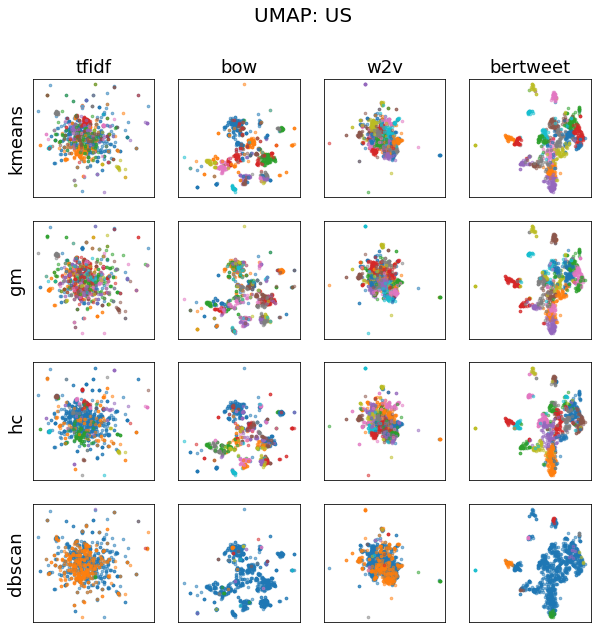

In [39]:
plot_prj("umap")

##### TSNE: US

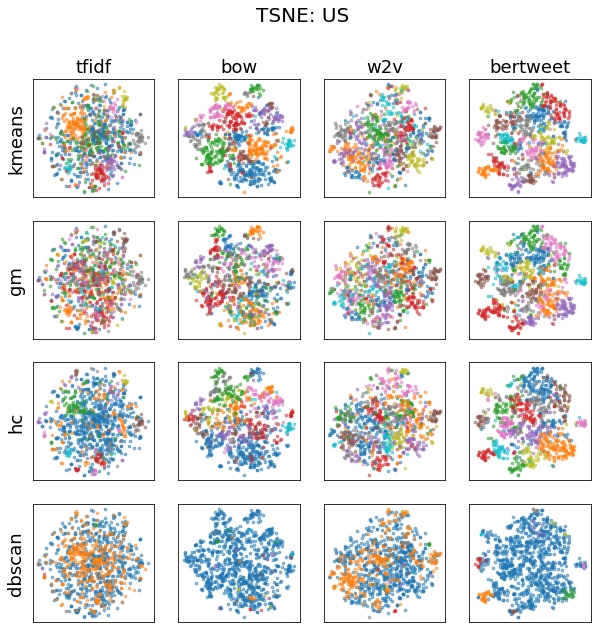

In [40]:
plot_prj("tsne")

##### PCA: US

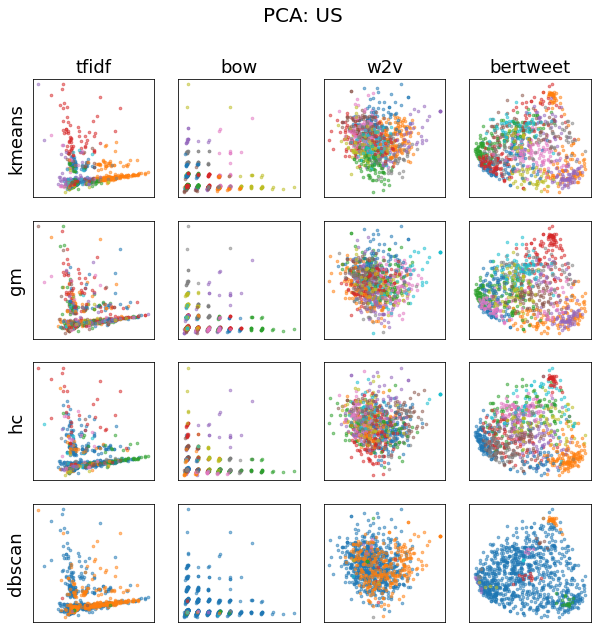

In [41]:
plot_prj("pca")